In [137]:
# Import the libraries
import numpy as np
import cv2
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go

# Define the paths to the data
path_img = "./data_odometry_gray/dataset/sequences/"

path_pose = "./data_odometry_poses/dataset/poses/"

# Load the pose data using pandas
num = "04"
poses = pd.read_csv(path_pose + ("%s.txt" % num), delimiter=' ', header=None)

# Extract the ground truth coordinates from the pose data
gt = np.array([np.array(poses.iloc[i]).reshape((3, 4)) for i in range(len(poses))])

# Extracting spatial coordinates from the gt tensor
z = gt[:, :, 3][:, 2]
y = gt[:, :, 3][:, 1]
x = gt[:, :, 3][:, 0]

# Creating a 3D scatter plot using Plotly
fig = go.Figure(data=[go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='lines',
    line=dict(color='red', width=2)
)])

# Customize the layout of the plot
fig.update_layout(scene=dict(
    xaxis_title='X',
    yaxis_title='Y',
    zaxis_title='Z',
    camera=dict(
        eye=dict(x=1.5, y=1.5, z=0.6),
        projection=dict(type='perspective')
    ),
    bgcolor='whitesmoke',
    xaxis=dict(showgrid=True, gridwidth=0.8, gridcolor='lightgray'),
    yaxis=dict(showgrid=True, gridwidth=0.8, gridcolor='lightgray'),
    zaxis=dict(showgrid=True, gridwidth=0.8, gridcolor='lightgray')
))

# Add a title to the plot for better context
fig.update_layout(title='Spatial Trajectory', title_font=dict(size=16, color='black'))

# Display the spatial trajectory plot
fig.show()


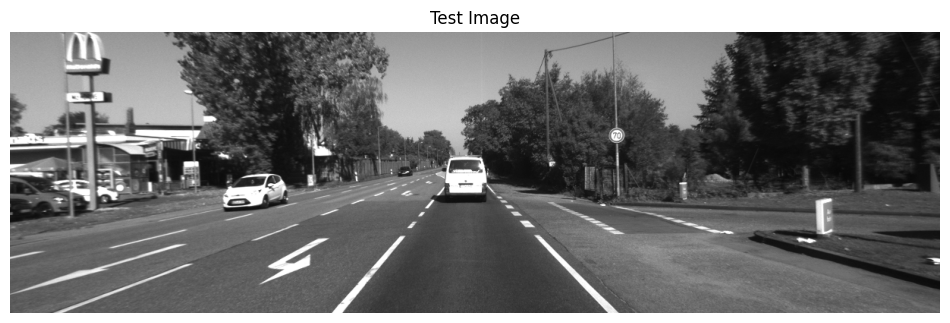

In [138]:
# Load and display a test image
test_img = cv2.imread(path_img + num + '/image_0/000000.png')
plt.figure(figsize=(12, 6))
plt.imshow(test_img)
plt.axis('off')
plt.title('Test Image')
plt.show()


In [139]:
import pandas as pd

# Read the times.txt file
times = pd.read_csv(path_img+num+'/times.txt', delimiter=' ', header=None)

# Display the first few rows
times.head()


,0
0,0.000000
1,0.104128
2,0.208254
3,0.312504
4,0.416625


In [140]:
import numpy as np
import matplotlib.pyplot as plt
print(path_img+num)
# Load the calibration data from calib.txt
calib = pd.read_csv(path_img+num+'/calib.txt',header=None, delimiter=' ',index_col=0)
calib.head()

./data_odometry_gray/dataset/sequences/04


,1,2,3,4,5,6,7,8,9,10,11,12
0,,,,,,,,,,,,
P0:,707.091200,0.000000,601.88730,0.000000,0.000000,707.091200,183.110400,0.000000,0.000000,0.000000,1.000000,0.000000
P1:,707.091200,0.000000,601.88730,-379.814500,0.000000,707.091200,183.110400,0.000000,0.000000,0.000000,1.000000,0.000000
P2:,707.091200,0.000000,601.88730,46.887830,0.000000,707.091200,183.110400,0.117860,0.000000,0.000000,1.000000,0.006203
P3:,707.091200,0.000000,601.88730,-333.459700,0.000000,707.091200,183.110400,1.930130,0.000000,0.000000,1.000000,0.003318
Tr:,-0.001858,-0.999966,-0.00804,-0.004784,-0.006481,0.008052,-0.999947,-0.073374,0.999977,-0.001806,-0.006496,-0.333997


In [141]:

# Extract the projection matrices and the transformation matrix
P0 = np.array(calib.loc['P0:']).reshape((3,4))
P1 = np.array(calib.loc['P1:']).reshape((3,4))
Tr = np.array(calib.loc['Tr:']).reshape((3,4))  # Updated line to extract the correct Tr matrix

In [142]:
# Extracting intrinsic and extrinsic parameters from the projection matrix P1
P1 = np.array(calib.loc['P1:']).reshape((3, 4))
k1, r1, t1, _, _, _, _ = cv2.decomposeProjectionMatrix(P1)
t1 = t1 / t1[3]

# Displaying the results
print('Intrinsic Matrix:')
print(k1)
print('Rotation Matrix:')
print(r1)
print('Translation Vector:')
print(t1.round(4))


Intrinsic Matrix:
[[707.0912   0.     601.8873]
 [  0.     707.0912 183.1104]
 [  0.       0.       1.    ]]
Rotation Matrix:
[[1. 0. 0.]
 [0. 1. 0.]
 [0. 0. 1.]]
Translation Vector:
[[ 0.5372]
 [-0.    ]
 [ 0.    ]
 [ 1.    ]]


In [143]:
some_point = np.array([1, 2, 3, 1]).reshape(-1, 1)
transformed_point = gt[14].dot(some_point)
depth_from_cam = transformed_point[2]

print('Original point:\n', some_point)
print('Transformed point:\n', transformed_point.round(4))
print('Depth from camera:\n', depth_from_cam.round(4))


Original point:
 [[1]
 [2]
 [3]
 [1]]
Transformed point:
 [[ 0.9994]
 [ 1.7591]
 [21.6264]]
Depth from camera:
 [21.6264]


In [144]:
# Multiplying by intrinsic matrix k, then dividing by depth
pixel_coordinates1 = k1.dot(transformed_point) / depth_from_cam

# Dividing by depth then multiplying by intrinsic matrix k
pixel_coordinates2 = k1.dot(transformed_point / depth_from_cam)

print('Pixel Coordinates (Approach 1):', pixel_coordinates1.T)
print('Pixel Coordinates (Approach 2):', pixel_coordinates2.T)


Pixel Coordinates (Approach 1): [[634.56474716 240.62638202   1.        ]]
Pixel Coordinates (Approach 2): [[634.56474716 240.62638202   1.        ]]


In [145]:
class Dataset_Handler():
    def __init__(self, sequence, lidar=True, progress_bar=True, low_memory=True):
        import pandas as pd
        import os
        import cv2
        import numpy as np
        from tqdm import tqdm

        self.lidar = lidar
        self.low_memory = low_memory

        self.seq_dir = './data_odometry_gray/dataset/sequences/{}/'.format(sequence)
        self.poses_dir = './data_odometry_poses/dataset/poses/{}.txt'.format(sequence)
        poses = pd.read_csv(self.poses_dir, delimiter=' ', header=None)

        self.left_image_files = os.listdir(self.seq_dir + 'image_0')
        self.right_image_files = os.listdir(self.seq_dir + 'image_1')
        self.velodyne_files = os.listdir(self.seq_dir + 'velodyne')
        self.num_frames = len(self.left_image_files)
        self.lidar_path = self.seq_dir + 'velodyne/'

        calib = pd.read_csv(self.seq_dir + 'calib.txt', delimiter=' ', header=None, index_col=0)
        self.P0 = np.array(calib.loc['P0:']).reshape((3,4))
        self.P1 = np.array(calib.loc['P1:']).reshape((3,4))
        self.P2 = np.array(calib.loc['P2:']).reshape((3,4))
        self.P3 = np.array(calib.loc['P3:']).reshape((3,4))
        self.Tr = np.array(calib.loc['Tr:']).reshape((3,4))

        self.times = np.array(pd.read_csv(self.seq_dir + 'times.txt', delimiter=' ', header=None))
        self.gt = np.zeros((len(poses), 3, 4))
        for i in range(len(poses)):
            self.gt[i] = np.array(poses.iloc[i]).reshape((3, 4))

        if self.low_memory:
            self.reset_frames()
            self.first_image_left = cv2.imread(self.seq_dir + 'image_0/' + self.left_image_files[0], 0)
            self.first_image_right = cv2.imread(self.seq_dir + 'image_1/' + self.right_image_files[0], 0)
            self.second_image_left = cv2.imread(self.seq_dir + 'image_0/' + self.left_image_files[1], 0)
            if self.lidar:
                self.first_pointcloud = np.fromfile(self.lidar_path + self.velodyne_files[0],
                                                    dtype=np.float32,
                                                    count=-1).reshape((-1, 4))
            self.imheight = self.first_image_left.shape[0]
            self.imwidth = self.first_image_left.shape[1]

        if progress_bar:
            bar = tqdm(total=self.num_frames, desc='Loading Images')

        self.images_left = []
        self.images_right = []
        self.pointclouds = []

        for i, name_left in enumerate(self.left_image_files):
            name_right = self.right_image_files[i]
            self.images_left.append(cv2.imread(self.seq_dir + 'image_0/' + name_left))
            self.images_right.append(cv2.imread(self.seq_dir + 'image_1/' + name_right))
            if self.lidar:
                pointcloud = np.fromfile(self.lidar_path + self.velodyne_files[i],
                                         dtype=np.float32,
                                         count=-1).reshape([-1, 4])
                self.pointclouds.append(pointcloud)
            if progress_bar:
                bar.update(1)

        if progress_bar:
            bar.close()

        self.imheight = self.images_left[0].shape[0]
        self.imwidth = self.images_left[0].shape[1]
        self.first_image_left = self.images_left[0]
        self.first_image_right = self.images_right[0]
        self.second_image_left = self.images_left[1]
        if self.lidar:
            self.first_pointcloud = self.pointclouds[0]
        else:
            if progress_bar:
                bar = tqdm(total=self.num_frames, desc='Loading Images')

            self.images_left = []
            self.images_right = []
            self.pointclouds = []

            for i, name_left in enumerate(self.left_image_files):
                name_right = self.right_image_files[i]
                self.images_left.append(cv2.imread(self.seq_dir + 'image_0/' + name_left))
                self.images_right.append(cv2.imread(self.seq_dir + 'image_1/' + name_right))
                if self.lidar:
                    pointcloud = np.fromfile(self.lidar_path + self.velodyne_files[i],
                                             dtype=np.float32,
                                             count=-1).reshape([-1,4])
                    self.pointclouds.append(pointcloud)
                if progress_bar:
                    bar.update(1)

            if progress_bar:
                bar.close()

            self.imheight = self.images_left[0].shape[0]
            self.imwidth = self.images_left[0].shape[1]
            self.first_image_left = self.images_left[0]
            self.first_image_right = self.images_right[0]
            self.second_image_left = self.images_left[1]
            if self.lidar:
                self.first_pointcloud = self.pointclouds[0]

    def reset_frames(self):
        self.images_left = (cv2.imread(self.seq_dir + 'image_0/' + name_left, 0)
                            for name_left in self.left_image_files)
        self.images_right = (cv2.imread(self.seq_dir + 'image_1/' + name_right, 0)
                            for name_right in self.right_image_files)
        if self.lidar:
            self.pointclouds = (np.fromfile(self.lidar_path + velodyne_file,
                                            dtype=np.float32,
                                            count=-1).reshape((-1, 4))
                                for velodyne_file in self.velodyne_files)


In [146]:
handler = Dataset_Handler('04')

Loading Images: 100%|████████████████████████| 271/271 [00:02<00:00, 101.31it/s]


In [147]:
import numpy as np
from scipy.spatial.transform import Rotation
import os

def calculate_baseline_and_focal_length(dataset_path):
    # Path to the KITTI odometry dataset
    calib_path = os.path.join(dataset_path, "calib.txt")

    with open(calib_path, 'r') as calib_file:
        calib_lines = calib_file.readlines()

    # Parse the calibration file
    for line in calib_lines:
        if line.startswith("P0:"):
            P0 = np.fromstring(line[3:], dtype=float, sep=' ').reshape((3, 4))
        elif line.startswith("P1:"):
            P1 = np.fromstring(line[3:], dtype=float, sep=' ').reshape((3, 4))
        elif line.startswith("Tr:"):
            Tr = np.fromstring(line[3:], dtype=float, sep=' ').reshape((3, 4))

    # Extract the baseline (distance between the left and right camera) from the Tr matrix
    print(np.shape(Tr))
    baseline = Tr[1, 3]

    # Extract the focal length from the P matrix (P0 and P1 are for the left and right cameras, respectively)
    focal_length = P0[0]

    return baseline, focal_length

# Example usage
kitti_dataset_path = path_img+num
baseline, focal_length = calculate_baseline_and_focal_length(kitti_dataset_path)

print("Baseline:", baseline)
print("Focal Length:", focal_length)


(3, 4)
Baseline: -0.07337429464231
Focal Length: [707.0912   0.     601.8873   0.    ]


In [148]:
import numpy as np
import cv2

# Projection matrix for the right camera
P1 = np.array(calib.loc['P1:']).reshape((3, 4))

# Decompose the projection matrix
k1, r1, t1, _, _, _, _ = cv2.decomposeProjectionMatrix(P1)
t1 = t1 / t1[3]

# Calculate the baseline (distance between the cameras)
baseline = abs(t1[0][0])

# Calculate the focal point (effective focal length of the cameras)
focal_length = k1[0][0]

# Print the results
print('Baseline:', baseline, 'meters')
print('Focal Length:', focal_length, 'pixels')


Baseline: 0.5371506532679236 meters
Focal Length: 707.0911999999998 pixels


In [149]:
import cv2
import numpy as np
import datetime
def compute_disp_left(img_left, img_right,sad_window,block_size, matcher_name='bm'):
    '''
    Compute the disparity map for the left image using the specified matcher.
    
    Arguments:
    img_left -- image from the left camera
    img_right -- image from the right camera
    
    Optional Argument:
    matcher_name -- (str) the matcher name, can be 'bm' for StereoBM or 'sgbm' for StereoSGBM matching
    
    Returns:
    disp_left -- disparity map for the left camera image
    '''
    
    # Set the parameters for disparity calculation
    num_disparities = sad_window * 16    
    # Convert the input images to grayscale
    img_left_gray = cv2.cvtColor(img_left, cv2.COLOR_BGR2GRAY)
    img_right_gray = cv2.cvtColor(img_right, cv2.COLOR_BGR2GRAY)

    # Create the stereo matcher based on the selected method
    if matcher_name == 'bm':
        matcher = cv2.StereoBM_create(numDisparities=num_disparities, blockSize=block_size)
    elif matcher_name == 'sgbm':                             
        matcher = cv2.StereoSGBM_create(
            numDisparities=num_disparities,
            minDisparity=0,
            blockSize=block_size,
            P1=8 * 3 * sad_window ** 2,
            P2=32 * 3 * sad_window ** 2,
            mode=cv2.STEREO_SGBM_MODE_SGBM_3WAY
        )

    # Compute the disparity map
    disparity = matcher.compute(img_left_gray, img_right_gray)

    # Normalize the disparity map for visualization
    disparity_normalized = cv2.normalize(disparity, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    
    # Compute the disparity map for the left camera image and return it
    start = datetime.datetime.now()
    disp_left = disparity.astype(np.float32) / 16
    end = datetime.datetime.now()
    print(f'Time to compute disparity map using Stereo{matcher_name.upper()}:', end-start)
    return disp_left


Time to compute disparity map using StereoBM: 0:00:00.000492


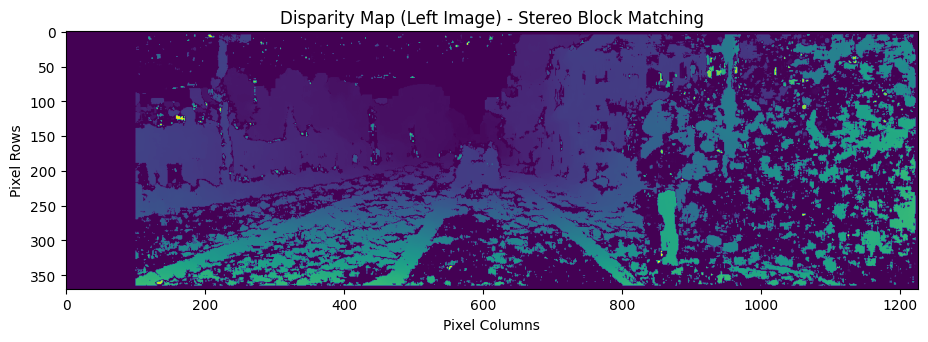

Time to compute disparity map using StereoSGBM: 0:00:00.000398


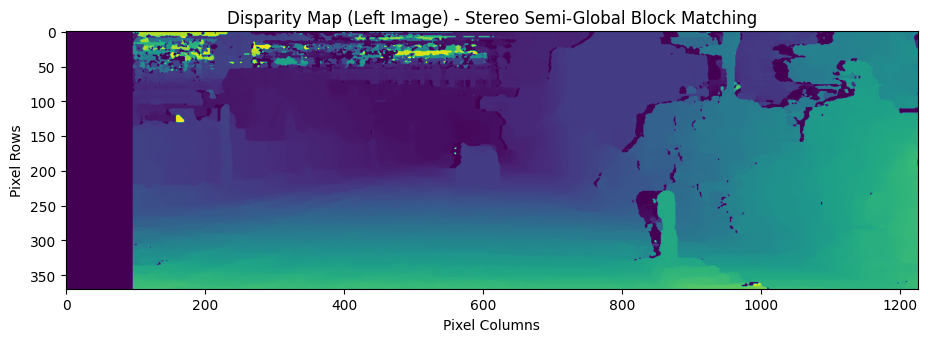

In [150]:
sad_window = 6
block_size = 11

disp_left = compute_disp_left(handler.first_image_left, handler.first_image_right, sad_window, block_size, matcher_name='bm')
# Set the figure size
plt.figure(figsize=(11, 7))
# Set the plot title
plt.title('Disparity Map (Left Image) - Stereo Block Matching')
# Display the disparity map
plt.imshow(disp_left)
# Add axis labels
plt.xlabel('Pixel Columns')
plt.ylabel('Pixel Rows')
# Show the plot
plt.show()

# Compute the disparity map for the left image
disp_left = compute_disp_left(handler.first_image_left, handler.first_image_right, sad_window, block_size, matcher_name='sgbm')
# Set the figure size
plt.figure(figsize=(11, 7))
# Set the plot title
plt.title('Disparity Map (Left Image) - Stereo Semi-Global Block Matching')
# Display the disparity map
plt.imshow(disp_left)
# Add axis labels
plt.xlabel('Pixel Columns')
plt.ylabel('Pixel Rows')
# Show the plotx
plt.show()


Time to compute disparity map using StereoBM: 0:00:00.000345


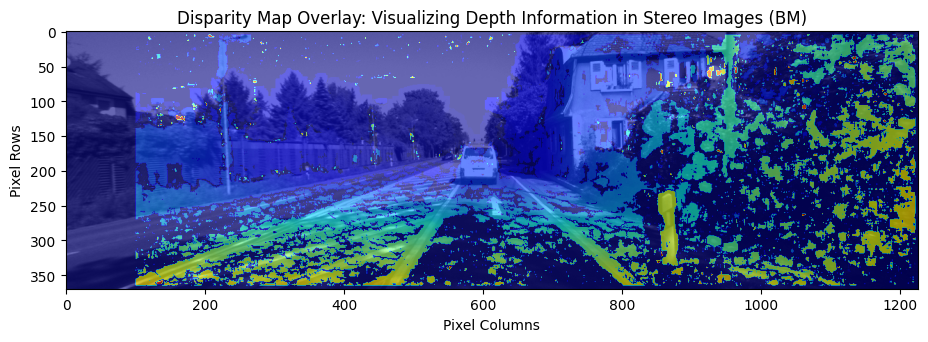

Time to compute disparity map using StereoSGBM: 0:00:00.000325


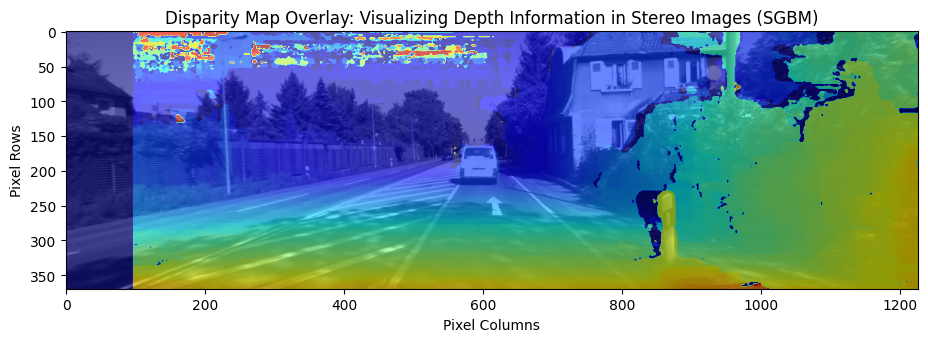

In [151]:

# Compute the disparity map
disp_left = compute_disp_left(handler.first_image_left, handler.first_image_right, sad_window, block_size, matcher_name='bm')

# Display the main image with the disparity map as overlay
plt.figure(figsize=(11, 7))
plt.title('Disparity Map Overlay: Visualizing Depth Information in Stereo Images (BM)')

plt.imshow(handler.first_image_left)
plt.imshow(disp_left, alpha=0.6, cmap='jet')
# Add axis labels
plt.xlabel('Pixel Columns')
plt.ylabel('Pixel Rows')
# Show the plot
plt.show()



# Compute the disparity map
disp_left = compute_disp_left(handler.first_image_left, handler.first_image_right, sad_window, block_size, matcher_name='sgbm')

# Display the main image with the disparity map as overlay
plt.figure(figsize=(11, 7))
plt.title('Disparity Map Overlay: Visualizing Depth Information in Stereo Images (SGBM)')

plt.imshow(handler.first_image_left)
plt.imshow(disp_left, alpha=0.6, cmap='jet')
# Add axis labels
plt.xlabel('Pixel Columns')
plt.ylabel('Pixel Rows')
# Show the plot
plt.show()



In [152]:
import cv2
# Load the input image
Image = handler.first_image_left
# Harris Corner Detection
gray = cv2.cvtColor(Image, cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)
dst = cv2.cornerHarris(gray, 2, 3, 0.04)

# Dilate the result for marking the corners
dst = cv2.dilate(dst, None)

# Create a copy of the image to display the detected corners
image = Image.copy()


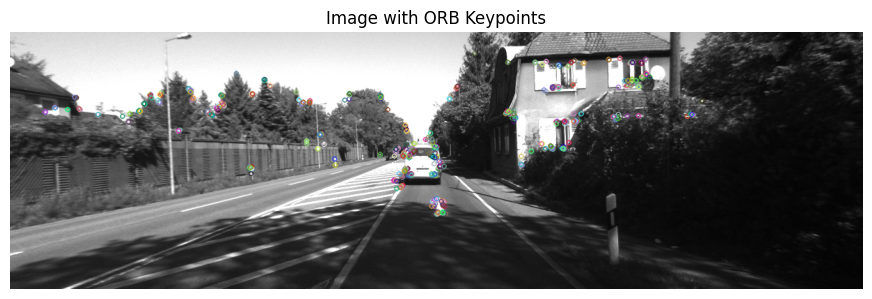

In [153]:
# Load the input image
Image = handler.first_image_left
# Harris Corner Detection
gray = cv2.cvtColor(Image, cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)
dst = cv2.cornerHarris(gray, 2, 3, 0.04)

# Dilate the result for marking the corners
dst = cv2.dilate(dst, None)

# Create a copy of the image to display the detected corners
image = Image.copy()
# Create ORB object
orb = cv2.ORB_create()

# Detect keypoints and compute descriptors
keypoints, descriptors = orb.detectAndCompute(image, None)

# Draw keypoints on the image
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None)

# Display the image with keypoints using matplotlib
plt.figure(figsize=(11, 6))
plt.imshow(image_with_keypoints, cmap='gray')
plt.title('Image with ORB Keypoints')
plt.axis('off')
plt.show()

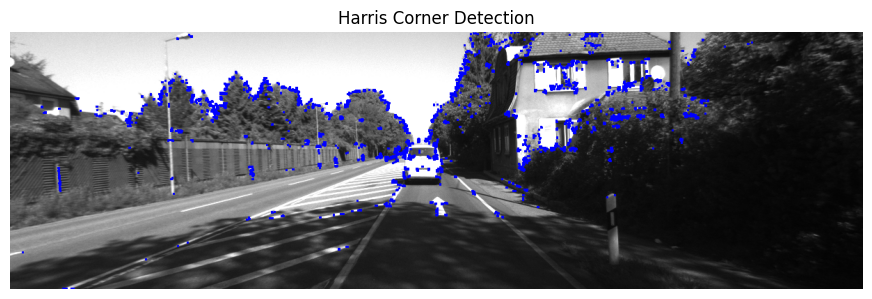

In [154]:
# Load the input image
Image = handler.first_image_left
# Harris Corner Detection
gray = cv2.cvtColor(Image, cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)
dst = cv2.cornerHarris(gray, 2, 3, 0.04)

# Dilate the result for marking the corners
dst = cv2.dilate(dst, None)

# Create a copy of the image to display the detected corners
image = Image.copy()

# Threshold for an optimal value, it may vary depending on the image.
image[dst>0.01*dst.max()]=[0,0,255]

# Display the image with detected corners
plt.figure(figsize=(11, 6))
plt.imshow(image, cmap='gray')
plt.title('Harris Corner Detection')
plt.axis('off')
plt.show()

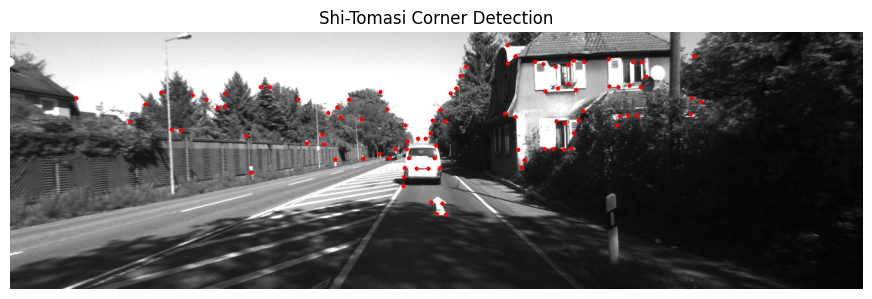

In [155]:
# Load the input image
Image = handler.first_image_left
# Harris Corner Detection
gray = cv2.cvtColor(Image, cv2.COLOR_BGR2GRAY)
gray = np.float32(gray)
dst = cv2.cornerHarris(gray, 2, 3, 0.04)

# Dilate the result for marking the corners
dst = cv2.dilate(dst, None)

# Create a copy of the image to display the detected corners
image = Image.copy()
# Parameters for corner detection
max_corners = 100
quality_level = 0.01
min_distance = 10

# Apply Shi-Tomasi Corner Detector
corners = cv2.goodFeaturesToTrack(gray, max_corners, quality_level, min_distance)

# Convert corners to integer coordinates
corners = np.int0(corners)

# Draw detected corners on the image
for corner in corners:
    x, y = corner.ravel()
    cv2.circle(image, (x, y), 3, 255, -1)

# Display the image with detected corners using matplotlib
plt.figure(figsize=(11, 6))
plt.imshow(image, cmap='gray')
plt.title('Shi-Tomasi Corner Detection')
plt.axis('off')
plt.show()


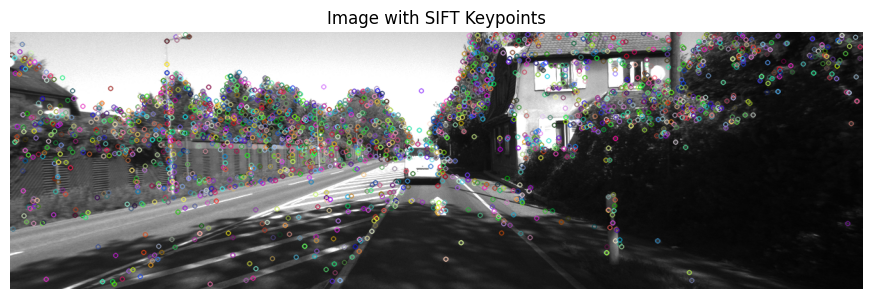

In [156]:
# Load the input image
Image = handler.first_image_left
# Create a copy of the image
image = Image.copy()
# Create SIFT object
sift = cv2.SIFT_create()

# Detect keypoints and compute descriptors
keypoints, descriptors = sift.detectAndCompute(image, None)

# Draw keypoints on the image
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None)
image = cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB)
# Display the image with keypoints using matplotlib
plt.figure(figsize=(11, 6))
plt.imshow(image)
plt.title('Image with SIFT Keypoints')
plt.axis('off')
plt.show()

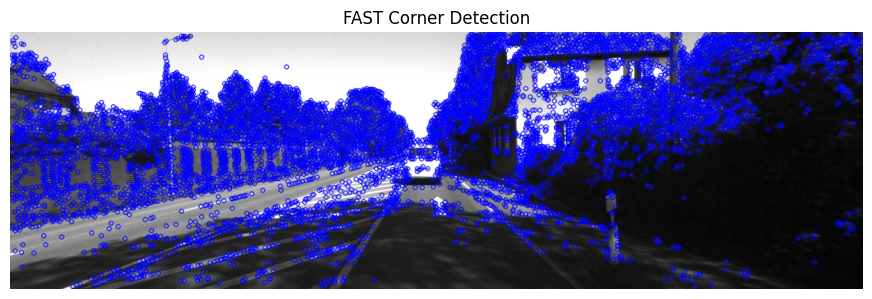

In [157]:
# Load the input image
Image = handler.first_image_left
# Create a copy of the image
image = Image.copy()

# Create FAST object
fast = cv2.FastFeatureDetector_create()

# Detect keypoints
keypoints = fast.detect(image, None)

# Draw keypoints on the image
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None, color=(255, 0, 0))

# Display the image with keypoints using matplotlib
plt.figure(figsize=(11, 6))
plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
plt.title('FAST Corner Detection')
plt.axis('off')
plt.show()

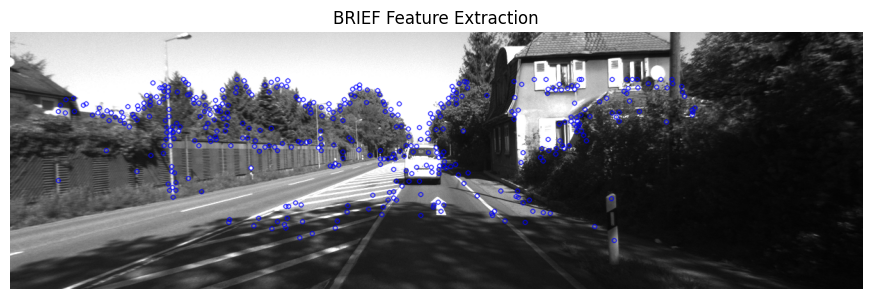

In [158]:
# Load the input image
Image = handler.first_image_left
# Create a copy of the image
image = Image.copy()

# Initiate FAST detector
star = cv2.xfeatures2d.StarDetector_create()
# Initiate BRIEF extractor
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()
# find the keypoints with STAR
kp = star.detect(image,None)
# compute the descriptors with BRIEF
kp, des = brief.compute(image, kp)

# Draw keypoints on the image
image_with_keypoints = cv2.drawKeypoints(image, kp, None, color=(255, 0, 0))

# Display the image with keypoints using matplotlib
plt.figure(figsize=(11, 6))
plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
plt.title('BRIEF Feature Extraction')
plt.axis('off')
plt.show()

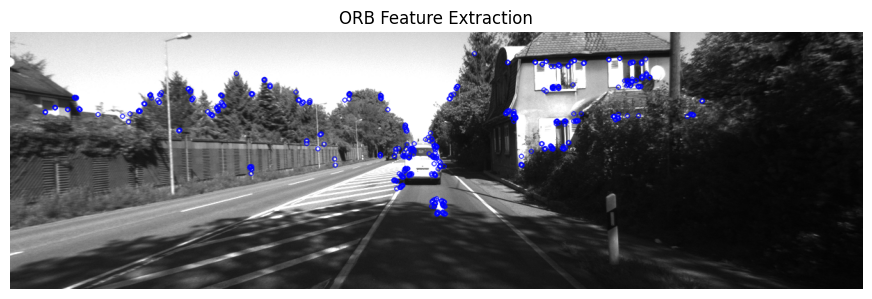

In [159]:
# Load the input image
Image = handler.first_image_left
# Create a copy of the image
image = Image.copy()

# Create ORB object
orb = cv2.ORB_create()

# Detect keypoints
keypoints = orb.detect(image, None)

# Compute ORB descriptors
keypoints, descriptors = orb.compute(image, keypoints)

# Draw keypoints on the image
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None, color=(255, 0, 0))

# Display the image with keypoints using matplotlib
plt.figure(figsize=(11, 6))
plt.imshow(cv2.cvtColor(image_with_keypoints, cv2.COLOR_BGR2RGB))
plt.title('ORB Feature Extraction')
plt.axis('off')
plt.show()


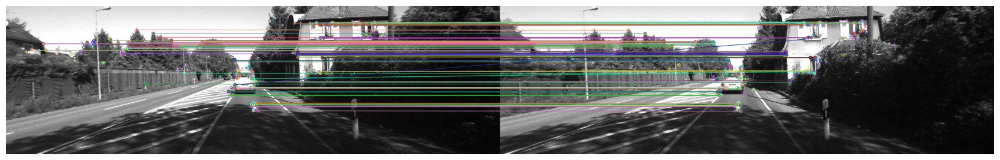

In [161]:

image1 = handler.first_image_left
image2 = handler.first_image_right

# Create feature detector and descriptor extractor
detector = cv2.ORB_create()
descriptor = cv2.ORB_create()

# Detect and compute keypoints and descriptors for both images
keypoints1, descriptors1 = detector.detectAndCompute(image1, None)
keypoints2, descriptors2 = detector.detectAndCompute(image2, None)
# Create a brute-force matcher with Euclidean distance
matcher = cv2.BFMatcher(cv2.NORM_L2)

# Perform matching
matches = matcher.match(descriptors1, descriptors2)

# Sort matches by distance
matches = sorted(matches, key=lambda x: x.distance)

# Draw top N matches
N = 100
matched_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches[:N], None)

# Convert the image to RGB format for display
matched_image_rgb = cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB)

# Display the matched image using matplotlib
plt.figure(figsize=(22, 8))
plt.imshow(matched_image_rgb)
plt.axis('off')
plt.show()


In [163]:
import numpy as np

def project_point_cloud_to_image(point_cloud, image_height, image_width, transformation_matrix, projection_matrix):
    """
    Projects a point cloud onto an image plane by transforming the X, Y, Z coordinates of the points
    to the camera frame using the transformation matrix, and then projecting them using the camera's
    projection matrix.
    
    Arguments:
    point_cloud -- array of shape Nx4 containing (X, Y, Z, reflectivity) coordinates of the point cloud
    image_height -- height (in pixels) of the image plane
    image_width -- width (in pixels) of the image plane
    transformation_matrix -- 3x4 transformation matrix between the lidar (X, Y, Z, 1) homogeneous and camera (X, Y, Z)
                             coordinate frames
    projection_matrix -- projection matrix of the camera (should have identity transformation if the
                         transformation matrix is used)
    
    Returns:
    rendered_image -- a (image_height x image_width) array containing depth (Z) information from the lidar scan
    """
    # Ignore points with X values less than or equal to zero (behind the lidar)
    point_cloud = point_cloud[point_cloud[:, 0] > 0]
    
    # Drop the last column (reflectivity) and replace it with ones to make coordinates homogeneous
    point_cloud_homogeneous = np.hstack([point_cloud[:, :3], np.ones((point_cloud.shape[0], 1))])
    
    # Transform the point cloud into the camera coordinate frame
    transformed_cloud = np.dot(transformation_matrix, point_cloud_homogeneous.T).T
    
    # Ignore points behind the camera
    transformed_cloud = transformed_cloud[transformed_cloud[:, 2] > 0]
    
    # Extract the Z coordinates (depth) from the camera
    depth = transformed_cloud[:, 2].copy()
    
    # Project the coordinates in the camera frame onto a flat plane at Z=1 by dividing by Z
    transformed_cloud /= transformed_cloud[:, 2].reshape(-1, 1)
    # Add a row of ones to make the 3D coordinates on the plane homogeneous for dotting with the projection matrix
    transformed_cloud_homogeneous = np.vstack([transformed_cloud.T, np.ones(transformed_cloud.shape[0])])
    
    # Get the pixel coordinates (X, Y) in the camera coordinate frame
    projected_points = np.dot(projection_matrix, transformed_cloud_homogeneous)
    projected_points = projected_points.T
    
    # Round the pixel coordinates to integers for indexing
    pixel_coordinates = np.round(projected_points[:, :2]).astype('int')
    
    # Limit the pixel coordinates to those within the image plane boundaries
    indices = np.where((pixel_coordinates[:, 0] < image_width)
                       & (pixel_coordinates[:, 0] >= 0)
                       & (pixel_coordinates[:, 1] < image_height)
                       & (pixel_coordinates[:, 1] >= 0))
    pixel_coordinates = pixel_coordinates[indices]
    depth = depth[indices]
    
    # Create an empty image, then fill it with the depths of each point
    rendered_image = np.zeros((image_height, image_width))
    for j, (u, v) in enumerate(pixel_coordinates):
        if 0 <= u < image_width and 0 <= v < image_height:
            rendered_image[v, u] = depth[j]
    
    # Fill zero values with a large distance so they will be ignored
    rendered_image[rendered_image == 0.0] = 3861.45
    
    return rendered_image


In [169]:
def pointcloud_to_image(pointcloud, image_height, image_width, transformation_matrix, projection_matrix):
    pointcloud = pointcloud[pointcloud[:, 0] > 0]
    pointcloud = np.hstack([pointcloud[:, :3], np.ones(pointcloud.shape[0]).reshape((-1,1))])
    cam_xyz = transformation_matrix.dot(pointcloud.T)
    cam_xyz = cam_xyz[:, cam_xyz[2] > 0]
    depth = cam_xyz[2].copy()
    cam_xyz /= cam_xyz[2]
    cam_xyz = np.vstack([cam_xyz, np.ones(cam_xyz.shape[1])])
    projection = projection_matrix.dot(cam_xyz)
    pixel_coordinates = np.round(projection.T, 0)[:, :2].astype('int')
    indices = np.where((pixel_coordinates[:, 0] < image_width)
                       & (pixel_coordinates[:, 0] >= 0)
                       & (pixel_coordinates[:, 1] < image_height)
                       & (pixel_coordinates[:, 1] >= 0)
                      )
    pixel_coordinates = pixel_coordinates[indices]
    depth = depth[indices]

    render = np.zeros((image_height, image_width))
    for j, (u, v) in enumerate(pixel_coordinates):
        if 0 <= u < image_width and 0 <= v < image_height:
            render[v, u] = depth[j]

    render[render == 0.0] = 3861.45

    return render


In [170]:
depth_lidar = pointcloud_to_image(handler.first_pointcloud, handler.imheight, handler.imwidth,
                               handler.Tr, handler.P0)
depth_stereo = compute_disp_left(handler.first_image_left, handler.first_image_right,5,11, matcher_name='bm')

Time to compute disparity map using StereoBM: 0:00:00.000321


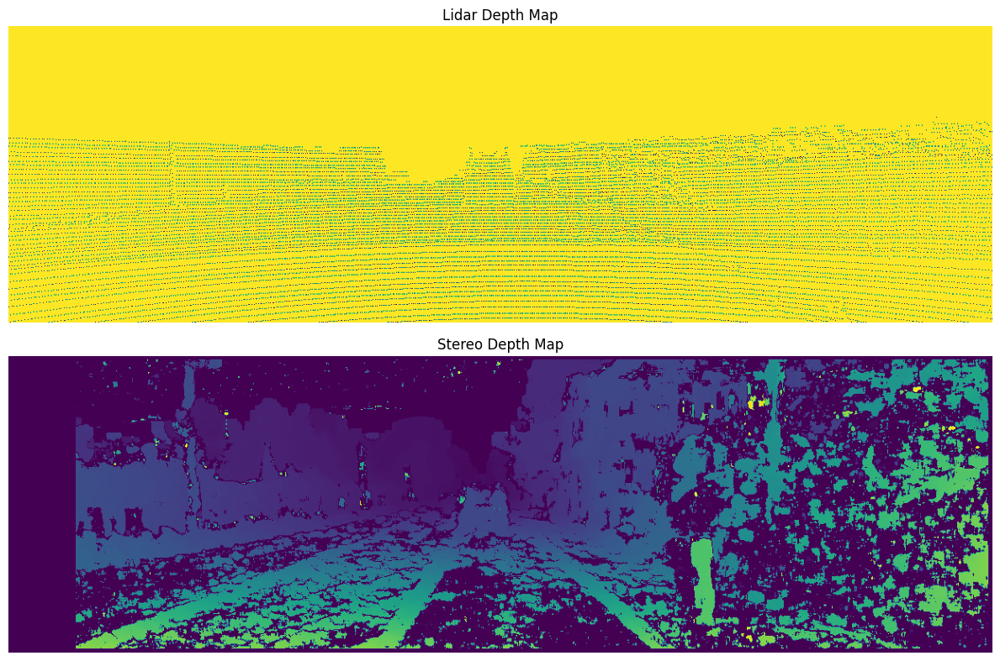

<Figure size 640x480 with 0 Axes>

In [171]:
fig, (ax1, ax2) = plt.subplots(2,1, figsize=(12, 8))

ax1.imshow(depth_lidar)
ax1.set_title('Lidar Depth Map')
ax1.axis('off')

ax2.imshow(depth_stereo)
ax2.set_title('Stereo Depth Map')
ax2.axis('off')

plt.tight_layout()
plt.show()
plt.savefig("Depth_map.png")

In [174]:
import numpy as np
import plotly.graph_objects as go

def visualize_pointcloud(pointcloud):
    """
    Visualizes a lidar point cloud using Plotly and saves it as an interactive HTML file.
    
    Arguments:
    pointcloud -- array of shape Nx4 containing (X, Y, Z, reflectivity) coordinates of the point cloud
    """
    # Extract coordinates from the point cloud
    xs = pointcloud[:, 0]
    ys = pointcloud[:, 1]
    zs = pointcloud[:, 2]

    # Create a 3D scatter plot
    fig = go.Figure(data=[go.Scatter3d(x=xs, y=ys, z=zs, mode='markers', marker=dict(size=1, color=zs, colorscale='Viridis'))])
    
    # Set the layout options
    fig.update_layout(scene=dict(aspectmode='data',
                                 xaxis=dict(showgrid=False, showticklabels=False),
                                 yaxis=dict(showgrid=False, showticklabels=False),
                                 zaxis=dict(showgrid=False, showticklabels=False)),
                      showlegend=False)

    # Save the figure as an interactive HTML file
    fig.write_html('pointcloud.html')

    # Show the plot
    fig.show()
pointcloud = handler.first_pointcloud
visualize_pointcloud(pointcloud)


In [179]:
def estimate_motion(match, kp1, kp2, k, depth1=None, max_depth=3000):
    """
    Estimate camera motion from a pair of subsequent image frames

    Arguments:
    match -- list of matched features from the pair of images
    kp1 -- list of the keypoints in the first image
    kp2 -- list of the keypoints in the second image
    k -- camera intrinsic calibration matrix 
    
    Optional arguments:
    depth1 -- Depth map of the first frame. Set to None to use Essential Matrix decomposition
    max_depth -- Threshold of depth to ignore matched features. 3000 is default

    Returns:
    rmat -- estimated 3x3 rotation matrix
    tvec -- estimated 3x1 translation vector
    image1_points -- matched feature pixel coordinates in the first image. 
                     image1_points[i] = [u, v] -> pixel coordinates of i-th match
    image2_points -- matched feature pixel coordinates in the second image. 
                     image2_points[i] = [u, v] -> pixel coordinates of i-th match
               
    """
    rmat = np.eye(3)
    tvec = np.zeros((3, 1))
    
    image1_points = np.float32([kp1[m.queryIdx].pt for m in match])
    image2_points = np.float32([kp2[m.trainIdx].pt for m in match])

    if depth1 is not None:
        cx = k[0, 2]
        cy = k[1, 2]
        fx = k[0, 0]
        fy = k[1, 1]
        object_points = np.zeros((0, 3))
        delete = []

        # Extract depth information of query image at match points and build 3D positions
        for i, (u, v) in enumerate(image1_points):
            z = depth1[int(v), int(u)]
            # If the depth at the position of our matched feature is above 3000, then we
            # ignore this feature because we don't actually know the depth and it will throw
            # our calculations off. We add its index to a list of coordinates to delete from our
            # keypoint lists, and continue the loop. After the loop, we remove these indices
            if z > max_depth:
                delete.append(i)
                continue
                
            # Use arithmetic to extract x and y (faster than using inverse of k)
            x = z*(u-cx)/fx
            y = z*(v-cy)/fy
            object_points = np.vstack([object_points, np.array([x, y, z])])
            # Equivalent math with dot product w/ inverse of k matrix, but SLOWER (see Appendix A)
            #object_points = np.vstack([object_points, np.linalg.inv(k).dot(z*np.array([u, v, 1]))])

        image1_points = np.delete(image1_points, delete, 0)
        image2_points = np.delete(image2_points, delete, 0)
        
        # Use PnP algorithm with RANSAC for robustness to outliers
        _, rvec, tvec, inliers = cv2.solvePnPRansac(object_points, image2_points, k, None)
        #print('Number of inliers: {}/{} matched features'.format(len(inliers), len(match)))
        
        # Above function returns axis angle rotation representation rvec, use Rodrigues formula
        # to convert this to our desired format of a 3x3 rotation matrix
        rmat = cv2.Rodrigues(rvec)[0]
    
    else:
        # With no depth provided, use essential matrix decomposition instead. This is not really
        # very useful, since you will get a 3D motion tracking but the scale will be ambiguous
        image1_points_hom = np.hstack([image1_points, np.ones(len(image1_points)).reshape(-1,1)])
        image2_points_hom = np.hstack([image2_points, np.ones(len(image2_points)).reshape(-1,1)])
        E = cv2.findEssentialMat(image1_points, image2_points, k)[0]
        _, rmat, tvec, mask = cv2.recoverPose(E, image1_points, image2_points, k)
    
    return rmat, tvec, image1_points, image2_points




image1 = handler.first_image_left
image2 = handler.first_image_right

# Create feature detector and descriptor extractor
detector = cv2.ORB_create()
descriptor = cv2.ORB_create()

# Detect and compute keypoints and descriptors for both images
keypoints1, descriptors1 = detector.detectAndCompute(image1, None)
keypoints2, descriptors2 = detector.detectAndCompute(image2, None)

# Create a brute-force matcher with Euclidean distance
matcher = cv2.BFMatcher(cv2.NORM_L2)

# Perform matching
matches = matcher.match(descriptors1, descriptors2)

# Sort matches by distance
matches = sorted(matches, key=lambda x: x.distance)

# Draw top N matches
N = 100
matched_image = cv2.drawMatches(image1, keypoints1, image2, keypoints2, matches[:N], None)

# Convert the image to RGB format for display
matched_image_rgb = cv2.cvtColor(matched_image, cv2.COLOR_BGR2RGB)


P0 = np.array(calib.loc['P0:']).reshape((3, 4))
k, _, _, _, _, _, _ = cv2.decomposeProjectionMatrix(P0)

rmat, tvec, img1_points, img2_points = estimate_motion(matches, keypoints1, keypoints2, k, depth1=None, max_depth=3000)


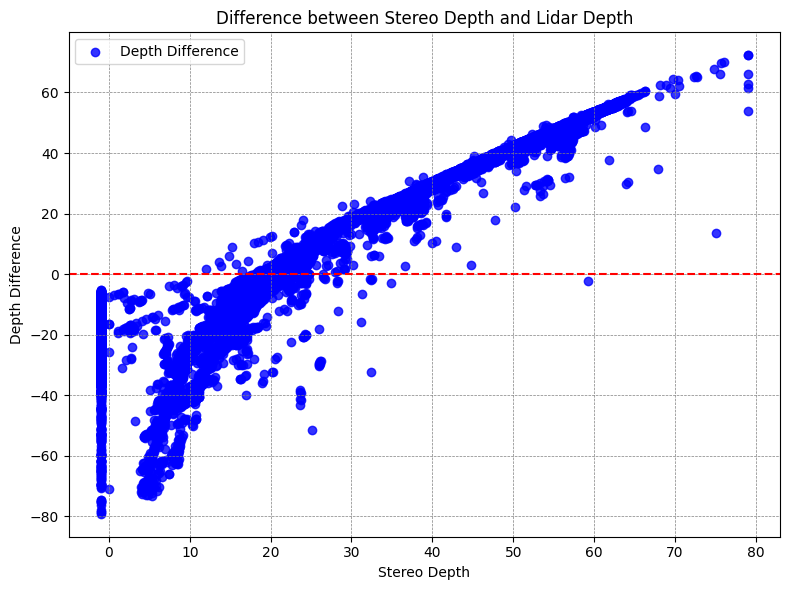

<Figure size 640x480 with 0 Axes>

In [177]:
# Filter depths from lidar below a threshold
lidar_threshold = 3000
valid_depth_indices = np.where(depth_lidar < lidar_threshold)
depth_indx = np.array(list(zip(*valid_depth_indices)))

# Extract depths for comparison
stereo_depths = depth_stereo[depth_indx[:, 0], depth_indx[:, 1]]
lidar_depths = depth_lidar[depth_indx[:, 0], depth_indx[:, 1]]

# Calculate the difference between stereo depth and lidar depth
depth_difference = stereo_depths - lidar_depths

# Create scatter plot for depth difference
fig, ax = plt.subplots(figsize=(8, 6))
ax.scatter(stereo_depths, depth_difference, c='b', label='Depth Difference', alpha=0.8)
ax.axhline(0, color='r', linestyle='--')
ax.set_xlabel('Stereo Depth')
ax.set_ylabel('Depth Difference')
ax.legend()

plt.title('Difference between Stereo Depth and Lidar Depth')
plt.grid(color='gray', linestyle='--', linewidth=0.5)
plt.tight_layout()
plt.show()
plt.savefig("stereoVSlidar.png")

In [180]:
import numpy as np
from scipy.spatial.transform import Rotation

class CameraMotionEstimator:
    def __init__(self, dataset_handler):
        self.dataset_handler = dataset_handler

    def estimate_motion(self):
        motion = []
        for i in range(self.dataset_handler.num_frames - 1):
            first_image_left = self.dataset_handler.images_left[i]
            second_image_left = self.dataset_handler.images_left[i + 1]

            # Convert images to grayscale if necessary
            if len(first_image_left.shape) == 3:
                first_image_left = cv2.cvtColor(first_image_left, cv2.COLOR_BGR2GRAY)
                second_image_left = cv2.cvtColor(second_image_left, cv2.COLOR_BGR2GRAY)

            # Perform feature matching and motion estimation
            keypoints1, keypoints2, matches = self.feature_matching(first_image_left, second_image_left)

            # Check if keypoints and matches are valid
            if keypoints1 is None or keypoints2 is None or len(matches) < 8:
                continue

            E, mask = cv2.findEssentialMat(keypoints1, keypoints2, self.dataset_handler.P0[:3, :3])

            # Recover camera motion from essential matrix
            _, R, t, _ = cv2.recoverPose(E, keypoints1, keypoints2, self.dataset_handler.P0[:3, :3])

            # Convert rotation matrix to quaternion
            rotation = Rotation.from_matrix(R)
            quaternion = rotation.as_quat()

            motion.append((quaternion, t))

        return motion

    def feature_matching(self, image1, image2):
        # Perform feature detection and description
        feature_detector = cv2.ORB_create()
        keypoints1, descriptors1 = feature_detector.detectAndCompute(image1, None)
        keypoints2, descriptors2 = feature_detector.detectAndCompute(image2, None)

        # Perform feature matching
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
        matches = matcher.match(descriptors1, descriptors2)

        # Filter matches using Lowe's ratio test
        ratio = 0.8
        filtered_matches = []
        for match in matches:
            if match.distance < ratio * match.distance:
                filtered_matches.append(match)

        # Extract matched keypoints
        keypoints1 = np.float32([keypoints1[match.queryIdx].pt for match in filtered_matches])
        keypoints2 = np.float32([keypoints2[match.trainIdx].pt for match in filtered_matches])

        return keypoints1, keypoints2, filtered_matches

# Example usage
dataset = Dataset_Handler(sequence='04')
estimator = CameraMotionEstimator(dataset)
motion = estimator.estimate_motion()

for i, (rotation, translation) in enumerate(motion):
    print(f"Frame {i+1}:")
    print("Rotation (quaternion):", rotation)
    print("Translation:", translation)
    print()


Loading Images: 100%|█████████████████████████| 271/271 [00:03<00:00, 68.02it/s]


In [ ]:
import numpy as np
import cv2
from scipy.spatial.transform import Rotation

class CameraMotionEstimator():
    def __init__(self, dataset_handler):
        self.dataset_handler = dataset_handler

    def estimate_motion(self):
        motion = []
        print(self.dataset_handler.num_frames)
        for i in range(self.dataset_handler.num_frames - 1):
            first_image_left = self.dataset_handler.images_left[i]
            second_image_left = self.dataset_handler.images_left[i + 1]
            
            # Convert images to grayscale if necessary
            if len(first_image_left.shape) == 3:
                first_image_left = cv2.cvtColor(first_image_left, cv2.COLOR_BGR2GRAY)
                second_image_left = cv2.cvtColor(second_image_left, cv2.COLOR_BGR2GRAY)

            # Perform feature matching and motion estimation
            keypoints1, keypoints2, matches = self.feature_matching(first_image_left, second_image_left)
            # Convert keypoints to numpy array
            keypoints1 = np.float32([keypoint.pt for keypoint in keypoints1])
            keypoints2 = np.float32([keypoint.pt for keypoint in keypoints2])

            E, mask = cv2.findEssentialMat(keypoints1, keypoints2, self.dataset_handler.P0[:3, :3])

            # Recover camera motion from essential matrix
            _, R, t, _ = cv2.recoverPose(E, keypoints1, keypoints2, self.dataset_handler.P0[:3, :3])

            # Convert rotation matrix to quaternion
            rotation = Rotation.from_matrix(R)
            quaternion = rotation.as_quat()
            motion.append((quaternion, t))

        return motion

    def feature_matching(self, image1, image2):
        # Perform feature detection and description
        detector = cv2.ORB_create()
        descriptor = cv2.ORB_create()
        
        keypoints1, descriptors1 = detector.detectAndCompute(image1, None)
        keypoints2, descriptors2 = detector.detectAndCompute(image2, None)
        
        # Perform feature matching
        matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
        matches = matcher.match(descriptors1, descriptors2)
        # Filter matches using Lowe's ratio test
        ratio = 0.8
        filtered_matches = []
        for match in matches:
            if match.distance < ratio * match.distance:
                filtered_matches.append(match)
        # Extract matched keypoints
        keypoints1 = np.float32([keypoints1[match.queryIdx].pt for match in filtered_matches])
        keypoints2 = np.float32([keypoints2[match.trainIdx].pt for match in filtered_matches])
        
        return keypoints1, keypoints2, filtered_matches


# Example usage
#dataset = Dataset_Handler(sequence='04')  # Make sure to define the 'Dataset_Handler' class
estimator = CameraMotionEstimator(dataset)
motion = estimator.estimate_motion()

for i, (rotation, translation) in enumerate(motion):
    print(f"Frame {i+1}:")
    print("Rotation (quaternion):", rotation)
    print("Translation:", translation)
    print()
    
print("done")


In [181]:
sequence = "04"
dataset = Dataset_Handler(sequence)
num_frames = dataset.num_frames
motion_estimates = []  # List to store the camera motion estimates
prev_image_left = dataset.first_image_left
prev_image_right = dataset.first_image_right
prev_pointcloud = dataset.first_pointcloud


Loading Images: 100%|█████████████████████████| 271/271 [00:03<00:00, 80.47it/s]


In [184]:
poses = pd.read_csv(path_pose + ("%s.txt" % "00"), delimiter=' ', header=None)
poses = np.array([np.array(poses.iloc[i]).reshape((3, 4)) for i in range(len(poses))])
pose = poses[:,:3,3]
rot = poses[:,:3,:3]

In [185]:
# Extracting spatial coordinates from the gt tensor
z = pose[:,2]
y = pose[:,1]
x = pose[:,0]

# Creating a 3D scatter plot using Plotly
fig = go.Figure(data=[go.Scatter3d(
    x=x,
    y=y,
    z=z,
    mode='lines',
    line=dict(color='red', width=2)
)])

# Customize the layout of the plot
fig.update_layout(scene=dict(
    xaxis_title='X',
    yaxis_title='Y',
    zaxis_title='Z',
    camera=dict(
        eye=dict(x=1.5, y=1.5, z=0.6),
        projection=dict(type='perspective')
    ),
    bgcolor='whitesmoke',
    xaxis=dict(showgrid=True, gridwidth=0.8, gridcolor='lightgray'),
    yaxis=dict(showgrid=True, gridwidth=0.8, gridcolor='lightgray'),
    zaxis=dict(showgrid=True, gridwidth=0.8, gridcolor='lightgray')
))

# Add a title to the plot for better context
fig.update_layout(title='Spatial Trajectory', title_font=dict(size=16, color='black'))

# Display the spatial trajectory plot
fig.show()

In [186]:
def dcm2quat(dcm):
    traces = np.trace(dcm, axis1=1, axis2=2)  # Calculate trace along the last two axes
    indices = traces > 0

    qw = np.zeros_like(traces)
    qx = np.zeros_like(traces)
    qy = np.zeros_like(traces)
    qz = np.zeros_like(traces)

    S = np.sqrt(traces[indices] + 1.0) * 2
    qw[indices] = 0.25 * S
    qx[indices] = (dcm[indices, 2, 1] - dcm[indices, 1, 2]) / S
    qy[indices] = (dcm[indices, 0, 2] - dcm[indices, 2, 0]) / S
    qz[indices] = (dcm[indices, 1, 0] - dcm[indices, 0, 1]) / S

    condition_1 = np.logical_and(~indices, dcm[:, 0, 0] > dcm[:, 1, 1])
    condition_2 = np.logical_and(condition_1, dcm[:, 0, 0] > dcm[:, 2, 2])

    S = np.sqrt(1.0 + dcm[condition_2, 0, 0] - dcm[condition_2, 1, 1] - dcm[condition_2, 2, 2]) * 2
    qw[condition_2] = (dcm[condition_2, 2, 1] - dcm[condition_2, 1, 2]) / S
    qx[condition_2] = 0.25 * S
    qy[condition_2] = (dcm[condition_2, 0, 1] + dcm[condition_2, 1, 0]) / S
    qz[condition_2] = (dcm[condition_2, 0, 2] + dcm[condition_2, 2, 0]) / S

    condition_3 = np.logical_and(~indices, ~condition_2, dcm[:, 1, 1] > dcm[:, 2, 2])

    S = np.sqrt(1.0 + dcm[condition_3, 1, 1] - dcm[condition_3, 0, 0] - dcm[condition_3, 2, 2]) * 2
    qw[condition_3] = (dcm[condition_3, 0, 2] - dcm[condition_3, 2, 0]) / S
    qx[condition_3] = (dcm[condition_3, 0, 1] + dcm[condition_3, 1, 0]) / S
    qy[condition_3] = 0.25 * S
    qz[condition_3] = (dcm[condition_3, 1, 2] + dcm[condition_3, 2, 1]) / S

    condition_4 = np.logical_and(~indices, ~condition_2, ~condition_3)

    S = np.sqrt(1.0 + dcm[condition_4, 2, 2] - dcm[condition_4, 0, 0] - dcm[condition_4, 1, 1]) * 2
    qw[condition_4] = (dcm[condition_4, 1, 0] - dcm[condition_4, 0, 1]) / S
    qx[condition_4] = (dcm[condition_4, 0, 2] + dcm[condition_4, 2, 0]) / S
    qy[condition_4] = (dcm[condition_4, 1, 2] + dcm[condition_4, 2, 1]) / S
    qz[condition_4] = 0.25 * S
    q = np.stack((qw, qx, qy, qz), axis=1)

    return q
